# Plot up maps of Uncertainty for pCO2-Residual technique 

In [2]:
# Modules

import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import cmocean as cm            # really nice colorbars
import matplotlib.pyplot as plt # for making plots
%matplotlib inline
%config InlineBackend.figure_format = 'jpeg'
%config InlineBackend.print_figure_kwargs = {'dpi':1200}

In [3]:
%run _Val_Mapping.ipynb

In [10]:
# Open file with pCO2_DIC, pCO2_T, and SOCAT pCO2
#run_dir = "/data/artemis/workspace/vbennington/SOCAT_ML/pCO2_DIC_Taka/models/reconstructions/xg"
run_dir = "/data/artemis/workspace/vbennington/SOCAT_ML/pCO2_DIC/models/reconstructions/xgr"
run_name = 'our_pco2'
alpha1 = 90
alpha2 = 67

In [16]:
fi = xr.Dataset({})

In [17]:
for alph in [alpha1, alpha2]:
    print(alph)
    fim = xr.open_dataset(f"{run_dir}/xgr_recon_alpha{alph}_pCO2_2D_mon_1x1_198201-201912.nc")
    fim = fim.transpose('time','ylat','xlon')
    fim = fim.rename({'ylat':'lat','xlon':'lon'})
    fi[f"alpha{alph}_range"] = fim.pCO2_DIC_upper_recon - fim.pCO2_DIC_lower_recon

90
67


In [18]:
print(fi)

<xarray.Dataset>
Dimensions:        (lat: 180, lon: 360, time: 456)
Coordinates:
  * time           (time) datetime64[ns] 1982-01-15 1982-02-15 ... 2019-12-15
  * lon            (lon) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
  * lat            (lat) float64 -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
Data variables:
    alpha90_range  (time, lat, lon) float64 nan nan nan nan ... nan nan nan nan
    alpha67_range  (time, lat, lon) float64 nan nan nan nan ... nan nan nan nan


# Mean Uncertainty by Alpha

19.713056585253486


/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


9.803379506050566


/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


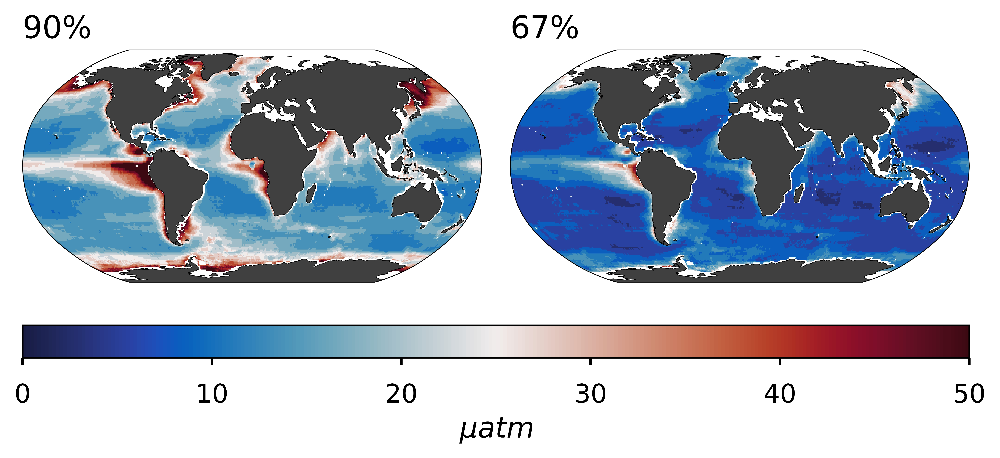

In [131]:
vrange = [0, 50, 20]
fig_shape = (1,2)
cmap = cm.cm.balance
lab = f'$\mu atm$'
      
with plt.style.context('seaborn-talk'):
    fig = plt.figure(figsize=(8.5,5))

    ### Mask
    dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal')
    
    data1 = fi[f"alpha{alpha1}_range"].mean("time").values/2
    print(np.nanmean(data1))
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=fim.lon)
    sub = dia.add_plot(lat = fim.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=0)
    dia.set_title(f"{alpha1}%", 0, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)
    
    data1 = fi[f"alpha{alpha2}_range"].mean("time").values/2
    print(np.nanmean(data1))
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=fim.lon)
    sub = dia.add_plot(lat = fim.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=1)
    dia.set_title(f"{alpha2}%", 1, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)
    
#fig.savefig(f"/home/vbennington/pCO2_Residual/SOCAT_Uncertainty_map_{run_name}.eps",format='eps',dpi=1200)
plt.show()

19.713056585253486


/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


9.803379506050566


/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


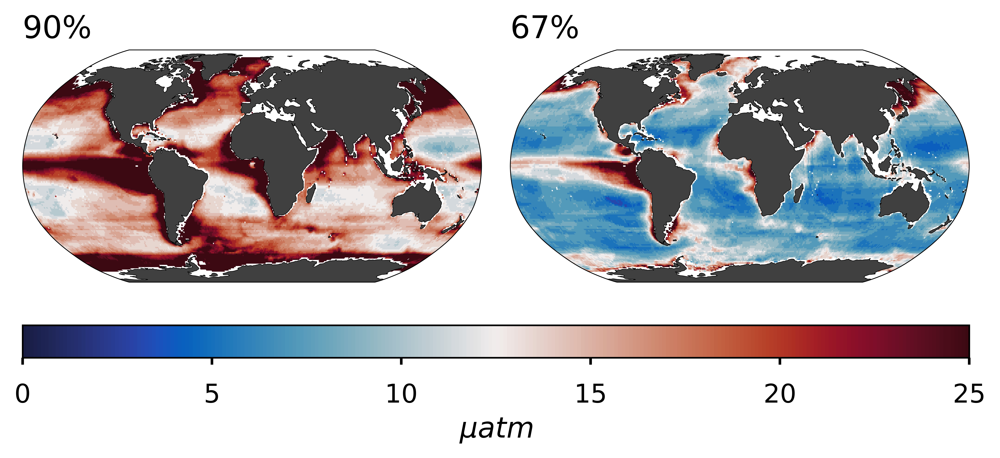

In [133]:
vrange = [0, 25, 26]
fig_shape = (1,2)
cmap = cm.cm.balance
lab = f'$\mu atm$'
      
with plt.style.context('seaborn-talk'):
    fig = plt.figure(figsize=(8.5,5))

    ### Mask
    dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal')
    
    data1 = fi[f"alpha{alpha1}_range"].mean("time").values/2
    print(np.nanmean(data1))
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=fim.lon)
    sub = dia.add_plot(lat = fim.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=0)
    dia.set_title(f"{alpha1}%", 0, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)
    
    data1 = fi[f"alpha{alpha2}_range"].mean("time").values/2
    print(np.nanmean(data1))
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=fim.lon)
    sub = dia.add_plot(lat = fim.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=1)
    dia.set_title(f"{alpha2}%", 1, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)

In [42]:
mc_dir = '/data/artemis/workspace/vbennington/SOCAT_ML/pCO2_DIC/models/reconstructions/xg'
du = xr.open_dataset(f"{mc_dir}/MonteCarlo_CO2Flux_pCO2_Residual_allyears_allwinds.nc")

sk = xr.open_dataset('/data/artemis/observations/SOCOM/extra_files/SeaFlux_v2021.04_kw_quadratic_scaled_1982-2020.nc')
kw = sk.kw.sel(wind=[f"CCMP2","ERA5","JRA55"]).squeeze()

In [53]:
flux_std = du.flux_std.where(du.flux_std!=0)

mask = xr.open_dataset('/data/artemis/observations/SOCOM/extra_files/RECCAP2_region_masks_all.nc') 
#replace longitude from 0-360 to -180 to 180
mask['lon'] = list(map(lambda x: x-360 if x>180 else x, mask['lon'].values))
# Sort by longitude
mask = mask.sortby('lon')
    
flux_std = flux_std.where(mask['open_ocean']>0)

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


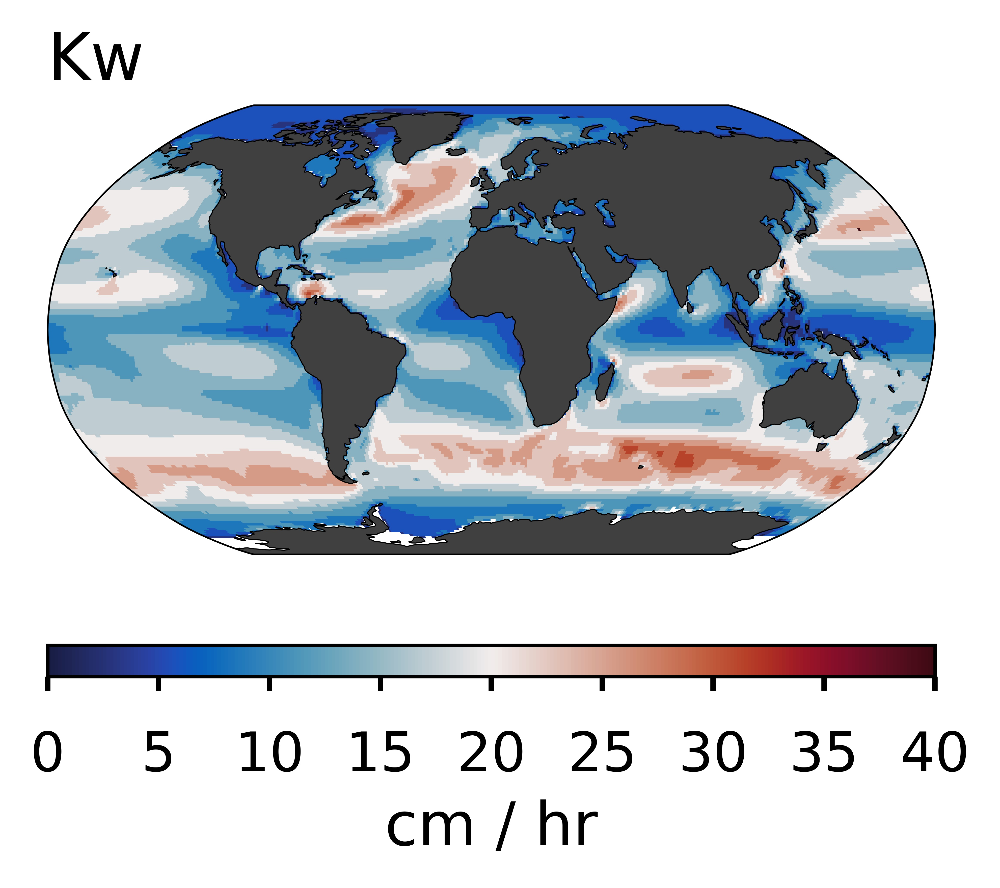

In [109]:
# Map CO2 Flux Uncertainty (STD):
vrange = [0,40,16]
fig_shape = (1,1)
cmap = cm.cm.balance
lab = f'cm / hr'
      
with plt.style.context('seaborn-talk'):
    fig = plt.figure(figsize=(4.25,2.5))

    ### Mask
    dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal')
    
    data1 = kw.mean(['time','wind']).values
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=sk.lon.values)
    sub = dia.add_plot(lat = sk.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=0)
    dia.set_title(f"Kw", 0, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)
    
fig.savefig(f"/home/vbennington/pCO2_Residual/kw_map_{run_name}.eps",format='eps',dpi=1200)
plt.show()

In [77]:
print(du)

<xarray.Dataset>
Dimensions:        (lat: 180, lon: 360, wind: 3, year: 38)
Coordinates:
  * year           (year) int64 1982 1983 1984 1985 1986 ... 2016 2017 2018 2019
  * wind           (wind) object 'CCMP2' 'ERA5' 'JRA55'
  * lat            (lat) float64 -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
  * lon            (lon) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Data variables:
    flux_mean      (wind, year, lat, lon) float64 nan nan ... -0.02335 -0.02334
    flux_std       (wind, year, lat, lon) float64 nan nan ... 2.29e-16 1.353e-16
    flux_PgC_mean  (wind, year) float64 ...
    flux_PgC_std   (wind, year) float64 ...


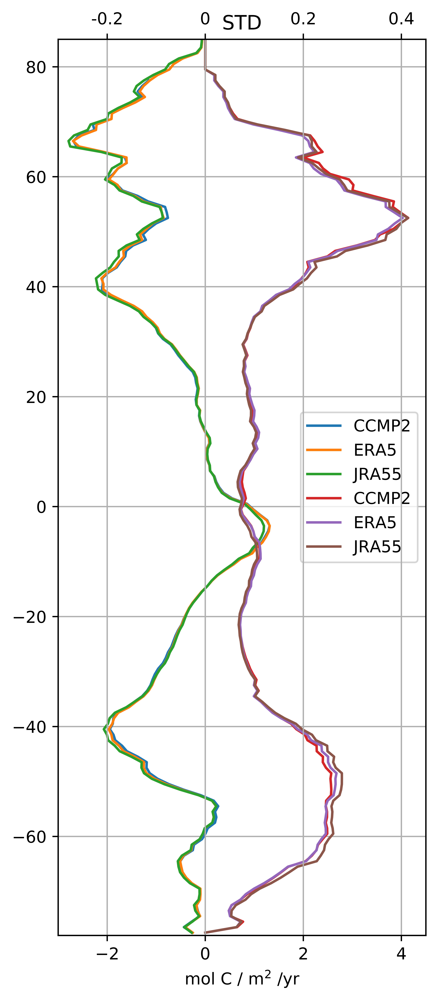

In [105]:
fig = plt.figure(figsize=(4,10))
plt.plot(du.flux_mean.sel(year=2015).mean(['lon']).transpose(),du.lat)
#axes1 = plt.gca()
#axes2 = axes1.twiny()
#axes2.set_xticks([-2.5, 0, 2.5])
#axes1.set_xlim(-3,2.5)
#axes2.set_xlim(-0.3,0.25)
plt.plot(du.flux_std.sel(year=2015).mean(['lon']).transpose()*10,du.lat)
axes1 = plt.gca()
axes1.set_xlim(-3,4.5)
axes2 = axes1.twiny()
axes2.set_xlim(-3,4.5)
axes2.set_xticks([-2,0,2,4])
axes2.set_xticklabels(["-0.2","0","0.2","0.4"])

axes1.set_xticks([-2,0,2,4])
plt.ylim(-78,85)
axes1.grid(True)
axes2.grid(True)
axes2.set_title('STD')
plt.ylabel(f"$^o$N")
axes1.set_xlabel(f"mol C / m$^2$ /yr")
axes1.legend(['CCMP2','ERA5','JRA55','CCMP2','ERA5','JRA55'])

fig.savefig(f"/home/vbennington/pCO2_Residual/Flux_Wind_STD_uncertainty_{run_name}.eps",format='eps',dpi=1200)
plt.show()


In [110]:
sarea = xr.open_dataset('/data/artemis/observations/SOCOM/extra_files/SeaFlux_v2021.04_area_ocean.nc')
area = sarea.area_ocean
print(area)

<xarray.DataArray 'area_ocean' (lat: 180, lon: 360)>
array([[0.000000e+00, 0.000000e+00, 0.000000e+00, ..., 0.000000e+00,
        0.000000e+00, 0.000000e+00],
       [0.000000e+00, 0.000000e+00, 0.000000e+00, ..., 0.000000e+00,
        0.000000e+00, 0.000000e+00],
       [0.000000e+00, 0.000000e+00, 0.000000e+00, ..., 0.000000e+00,
        0.000000e+00, 0.000000e+00],
       ...,
       [5.369219e+08, 5.369219e+08, 5.369219e+08, ..., 5.369219e+08,
        5.369219e+08, 5.369219e+08],
       [3.222160e+08, 3.222160e+08, 3.222160e+08, ..., 3.222160e+08,
        3.222160e+08, 3.222160e+08],
       [1.074159e+08, 1.074159e+08, 1.074159e+08, ..., 1.074159e+08,
        1.074159e+08, 1.074159e+08]], dtype=float32)
Coordinates:
  * lon      (lon) float64 -179.5 -178.5 -177.5 -176.5 ... 177.5 178.5 179.5
  * lat      (lat) float64 -89.5 -88.5 -87.5 -86.5 -85.5 ... 86.5 87.5 88.5 89.5
Attributes:
    units:        m2
    description:  Area of 1x1deg pixels for the ocean. The following inland w..

In [126]:
print(du)

<xarray.Dataset>
Dimensions:        (lat: 180, lon: 360, wind: 3, year: 38)
Coordinates:
  * year           (year) int64 1982 1983 1984 1985 1986 ... 2016 2017 2018 2019
  * wind           (wind) object 'CCMP2' 'ERA5' 'JRA55'
  * lat            (lat) float64 -89.5 -88.5 -87.5 -86.5 ... 86.5 87.5 88.5 89.5
  * lon            (lon) float64 -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Data variables:
    flux_mean      (wind, year, lat, lon) float64 nan nan ... -0.02335 -0.02334
    flux_std       (wind, year, lat, lon) float64 nan nan ... 2.29e-16 1.353e-16
    flux_PgC_mean  (wind, year) float64 ...
    flux_PgC_std   (wind, year) float64 ...


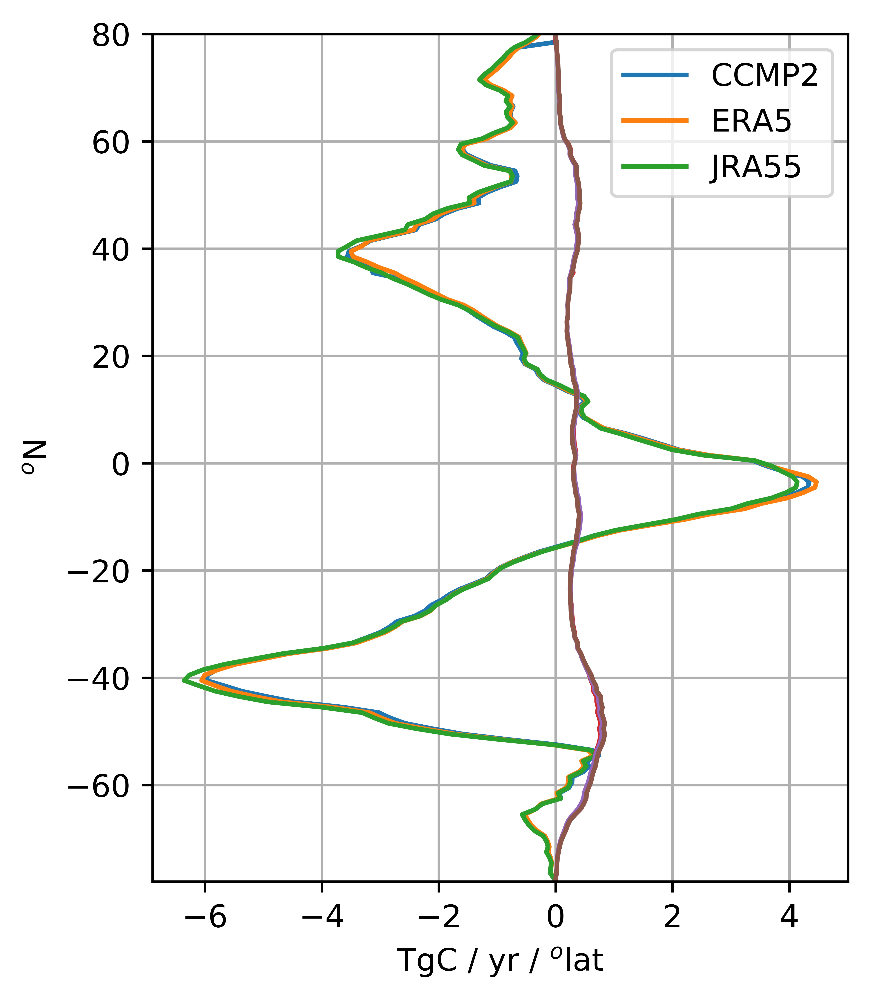

In [130]:
fig = plt.figure(figsize=(4,5))
plt.plot((du.flux_mean.sel(year=slice("1988","2019")).mean("year")*area).sum('lon').transpose()/(10**12),du.lat)
plt.plot((du.flux_std.sel(year=slice("1988","2019")).mean("year")*area).sum('lon').transpose()/(10**12),du.lat)
plt.ylim(-78,80)
plt.grid(True)
plt.ylabel(f"$^o$N")
plt.xlabel(f"TgC / yr / $^o$lat")
plt.legend(['CCMP2','ERA5','JRA55'])

fig.savefig(f"/home/vbennington/pCO2_Residual/Flux_Wind_STD_uncertainty_allyrs_{run_name}.eps",format='eps',dpi=1200)
plt.show()

/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in less
  
/home/vbennington/.conda/envs/dev2/lib/python3.6/site-packages/cartopy/util.py:102: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  new_data = ma.concatenate((data, data[slicer]), axis=axis)


0.00031230172615779776


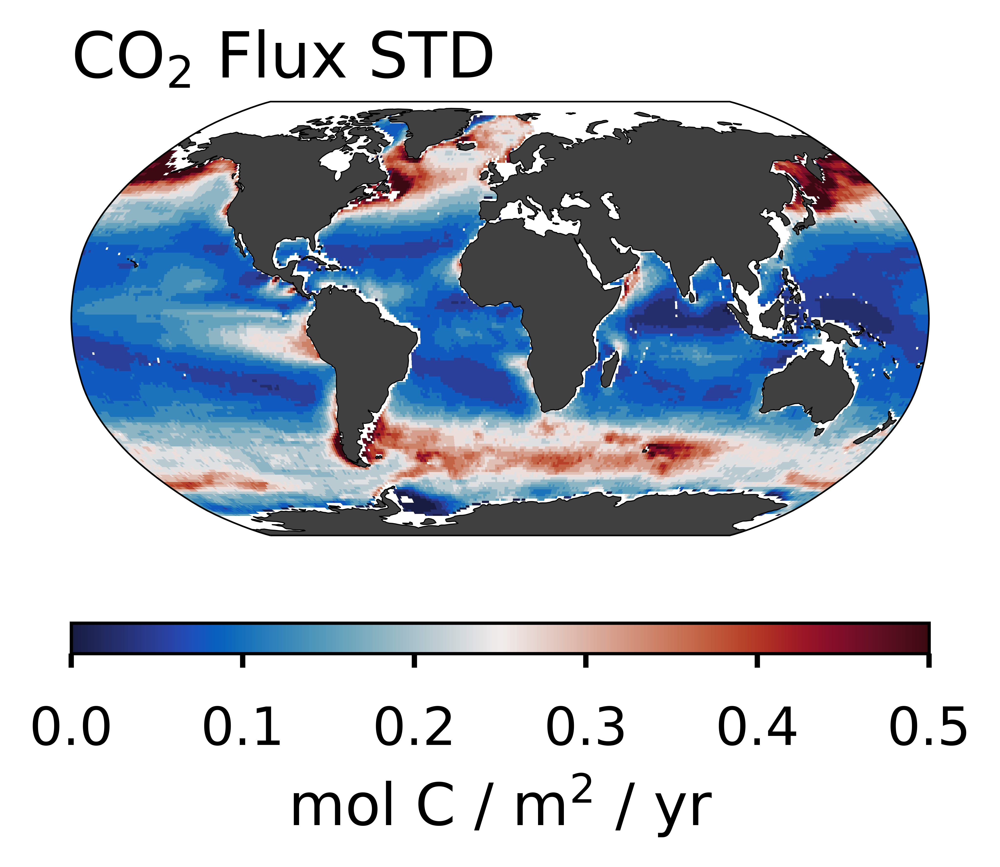

In [123]:
# Map CO2 Flux Uncertainty (STD):
vrange = [0,0.5,21]
fig_shape = (1,1)
cmap = cm.cm.balance
lab = f'mol C / m$^2$ / yr'
      
with plt.style.context('seaborn-talk'):
    fig = plt.figure(figsize=(4.25,2.5))

    ### Mask
    dia = SpatialMap2(nrows_ncols=fig_shape, fig=fig, cbar_location='bottom', cbar_orientation='horizontal')
    
    data1 = flux_std.sel(year=slice('1988','2019')).mean(['wind','year']).values
    data1 = np.where(data1<1e-5,np.nan,data1)
    print(np.nanmin(data1))
    wrap_data, wrap_lon = add_cyclic_point(data1, coord=du.lon.values)
    sub = dia.add_plot(lat = du.lat, 
                           lon = wrap_lon, 
                           data = wrap_data, 
                           vrange=vrange[0:2], 
                           cmap=cmap, 
                           ncolors=vrange[2],
                           ax=0)
    dia.set_title(f"CO$_2$ Flux STD", 0, loc="left")
    col = dia.add_colorbar(sub)
    dia.set_cbar_xlabel(col, lab)
    

fig.savefig(f"/home/vbennington/pCO2_Residual/Map_Flux_STD_uncertainty_allyears_{run_name}.eps",format='eps',dpi=1200)
plt.show()

# Time Series by Biome

In [24]:
bfile = '/data/artemis/observations/Biomes_FayMcKinley/Time_Varying_Biomes.nc'
BIOMES = xr.load_dataset(f"{bfile}")
BIOMES = BIOMES.transpose('year','lat','lon')

 Biomes as in Fay and McKinley (2014) <br>
 1 = North Pacific Ice (NP ICE) <br>
 2 = North Pacific Subpolar (NP SPSS) <br>
 3 = NP STSS <br>
 4 = NS STPS <br>
 5 = Pac EQU W <br>
 6 = Pac EQU E <br>
 7 = SP STPS <br>
 8 = NA Ice <br>
 9 = NA SPSS <br>
 10 = NA STSS <br>
 11 = NA STPS <br>
 12 = Atl EQU <br>
 13 = SA STPS <br>
 14 IND STPS <br>
 15 SO STSS <br>
 16 SO SPSS <br>
 17 = SO ICE <br>

In [27]:
b_id = [2, 6, 7, 15, 16]
b_id = [2,3,4,5,6,7,9,10,11,12,13,14,15,16]
blabels = ['NP SPSS','Pac Equ E','SP STPS','SO STSS','SO SPSS']
blabels = ['NP SPSS','NP STSS','NS STPS','Pac Equ W','Pac Equ E','SP STPS','NA SPSS','NA STSS','NA STPS','Atl Eq','SA STPS','IND STPS','SO STSS','SO SPSS']

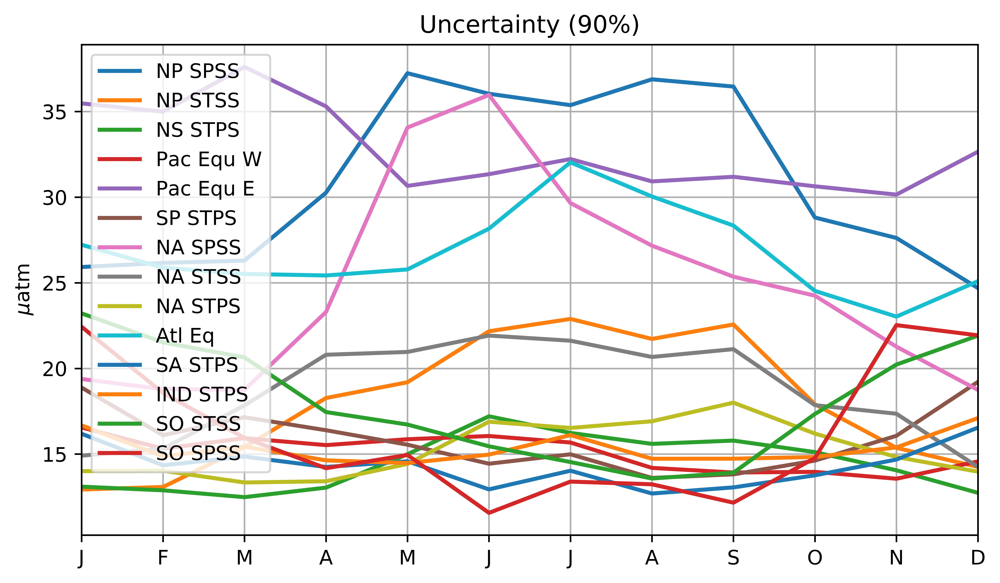

In [32]:
fig = plt.figure(figsize=(8,4.5))
for i in range(0,len(b_id)):
    plt.plot(fi['alpha90_range'].where(BIOMES.MeanBiomes==b_id[i]).mean(["lat","lon"]).groupby("time.month").mean("time")/2,label=f"{blabels[i]}",linewidth=2)
plt.grid(True)
plt.legend()
plt.ylabel(f"$\mu$atm")
plt.title(f"Uncertainty (90%)")
plt.xlim(0,11)
plt.xticks([0,1,2,3,4,5,6,7,8,9,10,11],['J','F','M','A','M','J','J','A','S','O','N','D'])
#fig.savefig("/home/vbennington/pCO2_Residual/SOCAT_FI_SST_biomes_seas_cycle.eps",format='eps',dpi=1200)
plt.show()

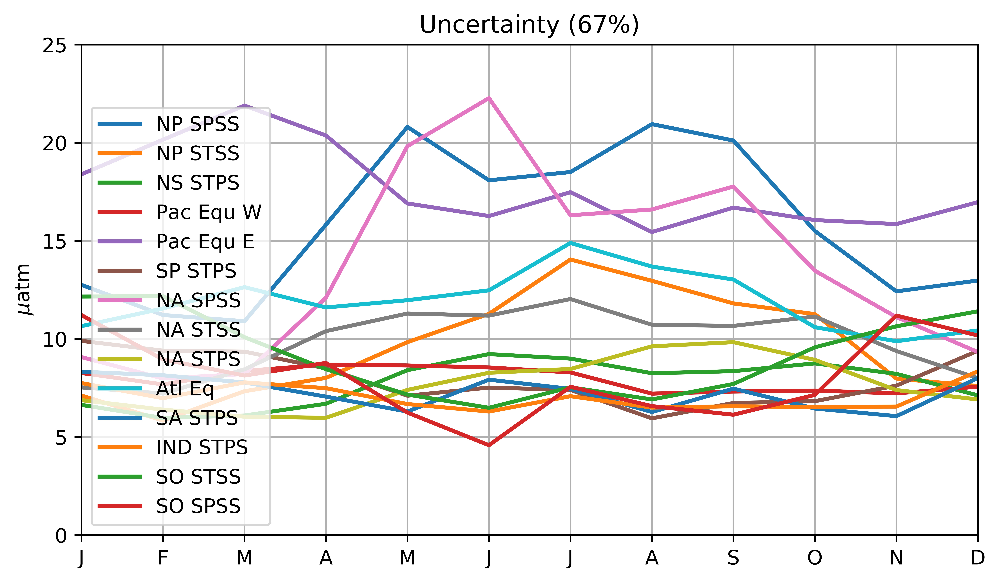

In [33]:
fig = plt.figure(figsize=(8,4.5))
for i in range(0,len(b_id)):
    plt.plot(fi['alpha67_range'].where(BIOMES.MeanBiomes==b_id[i]).mean(["lat","lon"]).groupby("time.month").mean("time")/2,label=f"{blabels[i]}",linewidth=2)
plt.grid(True)
plt.legend()
plt.ylabel(f"$\mu$atm")
plt.title(f"Uncertainty (67%)")
plt.xlim(0,11)
plt.ylim(0,25)
plt.xticks([0,1,2,3,4,5,6,7,8,9,10,11],['J','F','M','A','M','J','J','A','S','O','N','D'])
#fig.savefig("/home/vbennington/pCO2_Residual/SOCAT_FI_SST_biomes_seas_cycle.eps",format='eps',dpi=1200)
plt.show()